In [3]:
import sys
sys.path.append("..")
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0"  # or "0,1" for multiple GPUs

In [4]:
from grins.config import EXTERNAL_DATA_DIR
import pandas as pd
import os
from PIL import Image
import torch
from diffusers import FluxKontextPipeline
from diffusers.utils import load_image
from diffusers.quantizers import PipelineQuantizationConfig
# Draw a red bounding box at the center of input_image
from PIL import ImageDraw

In [5]:
MIT_PLACE_PULSE_DIR = EXTERNAL_DATA_DIR / "mit-place-pulse"
IMAGES_DIR = MIT_PLACE_PULSE_DIR / "gsv" / "final_photo_dataset"

In [6]:
pipeline_quant_config = PipelineQuantizationConfig(
    quant_backend="bitsandbytes_4bit",
    quant_kwargs={
        "load_in_4bit": True,
        "bnb_4bit_quant_type": "nf4",
        "bnb_4bit_use_double_quant": True,
        "bnb_4bit_compute_dtype": torch.bfloat16,
    },
    components_to_quantize=["transformer", "text_encoder_2"],
)

pipe = FluxKontextPipeline.from_pretrained(
    "black-forest-labs/FLUX.1-Kontext-dev",
    quantization_config=pipeline_quant_config,
    torch_dtype=torch.bfloat16,
).to("cuda")

Loading pipeline components...: 100%|██████████| 7/7 [00:13<00:00,  1.89s/it]


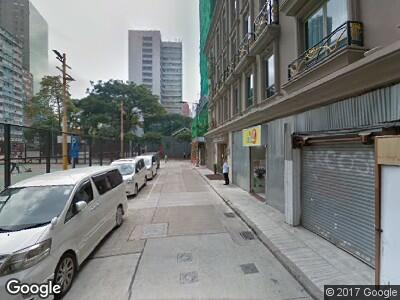

In [7]:
input_image = Image.open(IMAGES_DIR / "50e5f7d4d7c3df413b00056a.jpg").convert("RGB")
input_image

100%|██████████| 28/28 [00:40<00:00,  1.45s/it]


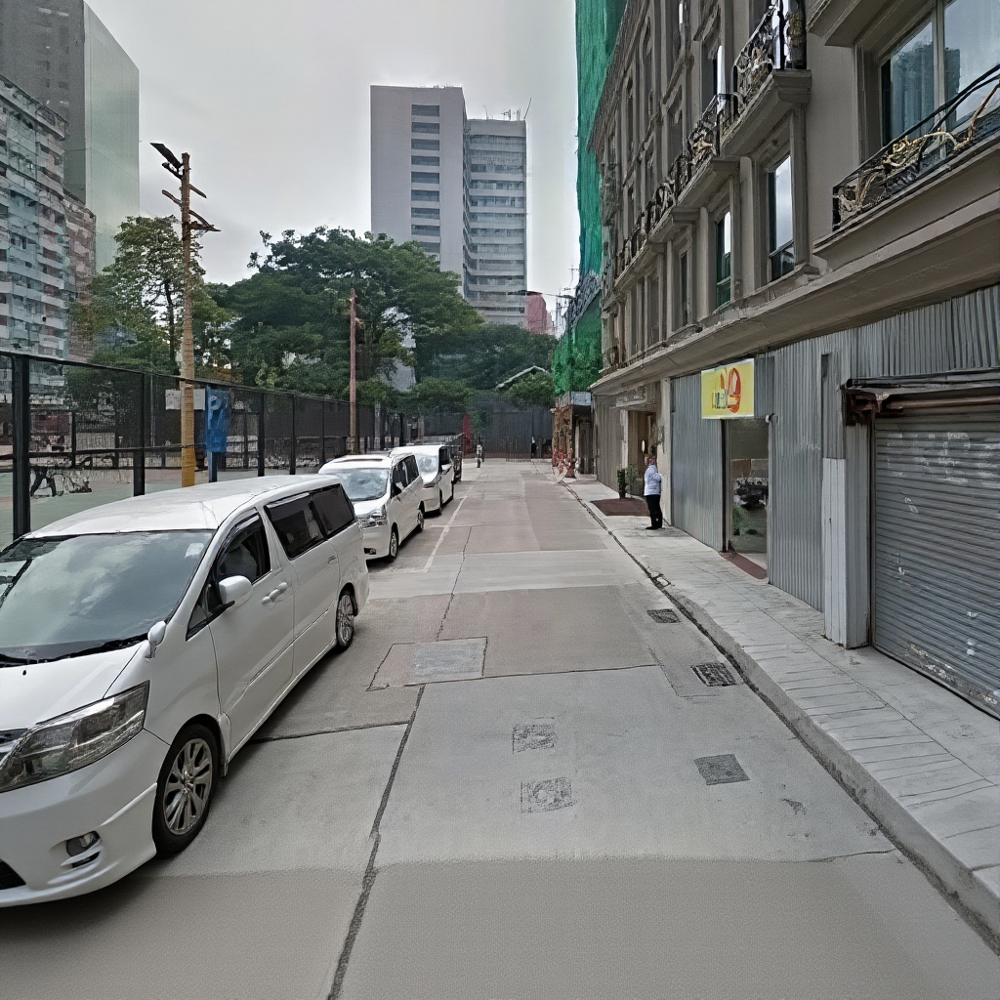

In [8]:
image = pipe(image=input_image, prompt="Improve the resolution and quality of the image, and remove the Google watermarks, while keeping the content unchanged.", guidance_scale=2.5).images[0]
display(image)

In [9]:
import json

with open("output.jsonl", "r", encoding="utf-8") as f:
    output = [json.loads(line) for line in f]
    
output

[{'bbox_2d': [684, 350, 741, 410],
  'prompt': 'Replace the sign with a vibrant, colorful mural depicting local culture and landmarks.'},
 {'bbox_2d': [598, 428, 651, 520],
  'prompt': 'Paint the building façade in a soft, calming blue to create a serene atmosphere.'},
 {'bbox_2d': [3, 462, 365, 882],
  'prompt': "Add a sleek, modern car with a glossy finish to enhance the street's vibrancy."},
 {'bbox_2d': [314, 444, 418, 552],
  'prompt': 'Paint the car in a bright, cheerful color scheme to make it stand out.'},
 {'bbox_2d': [542, 446, 568, 470],
  'prompt': 'Add a small, decorative fountain to the sidewalk for a refreshing touch.'}]

In [10]:
output = [
    "Add visible security cameras along the street.",
    "Install motion-activated streetlights.",
    "Paint the curb white.",
    "Trim overgrown vegetation.",
    "Install a pedestrian crossing signal.",
]

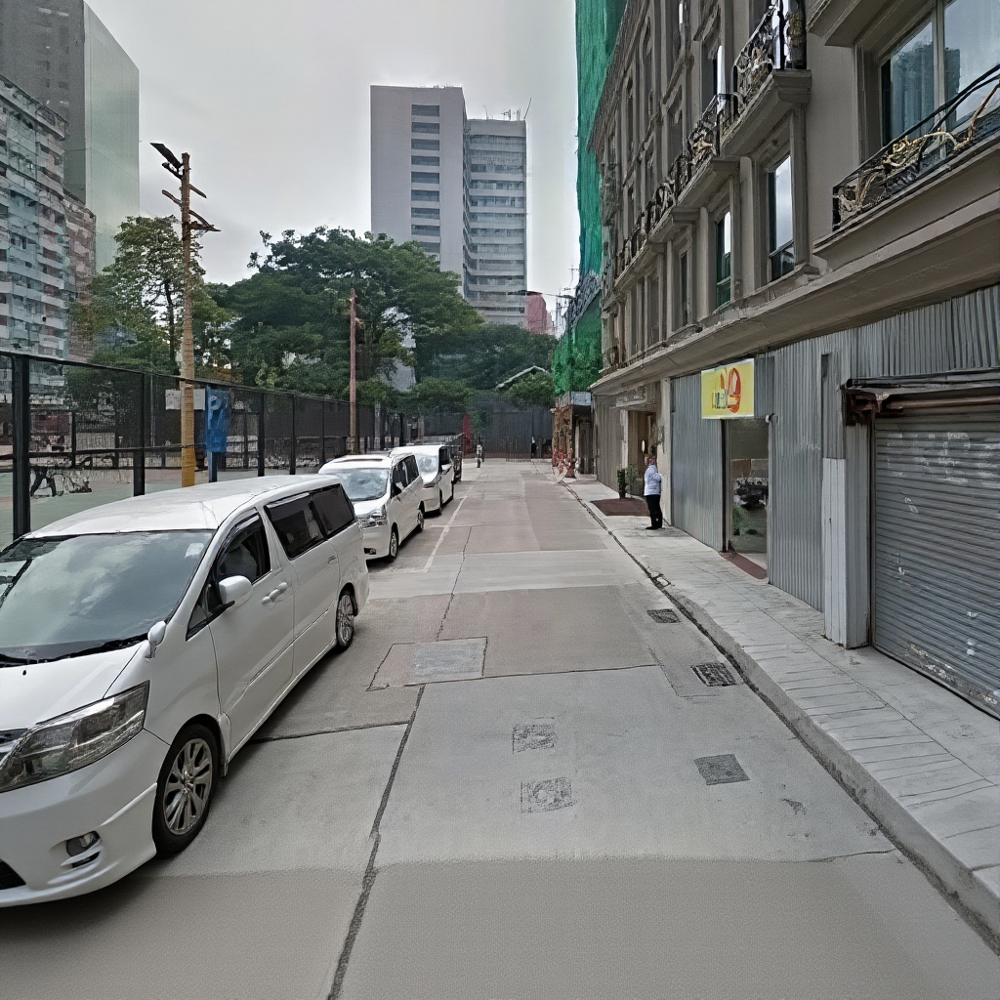

  4%|▎         | 1/28 [00:01<00:29,  1.08s/it]

100%|██████████| 28/28 [00:40<00:00,  1.45s/it]


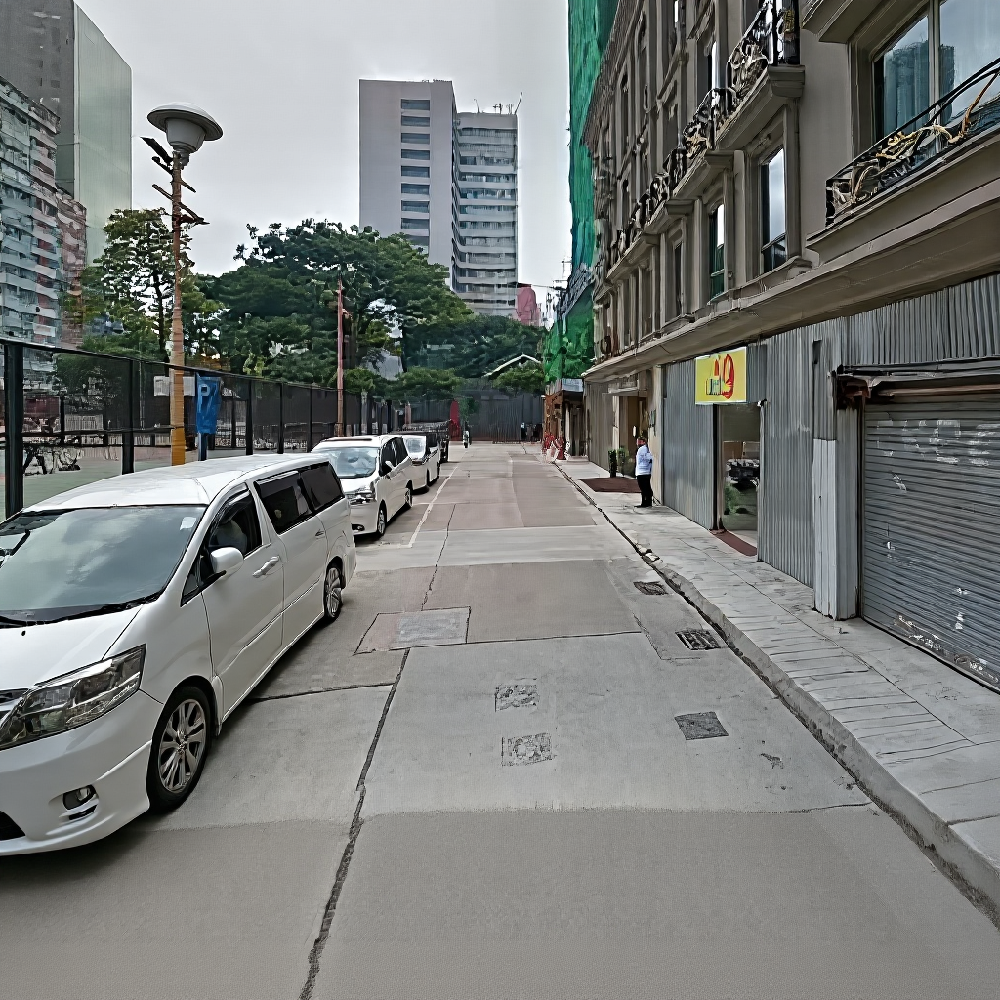

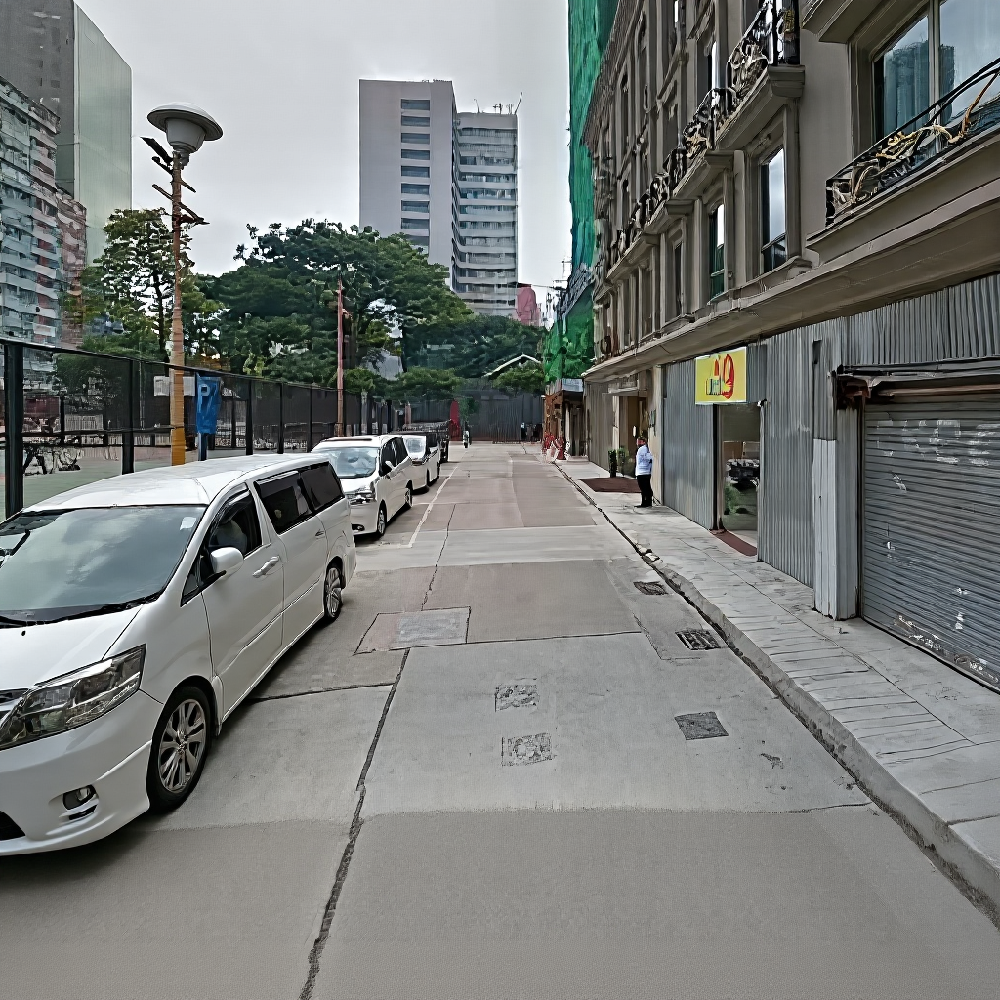

100%|██████████| 28/28 [00:40<00:00,  1.46s/it]


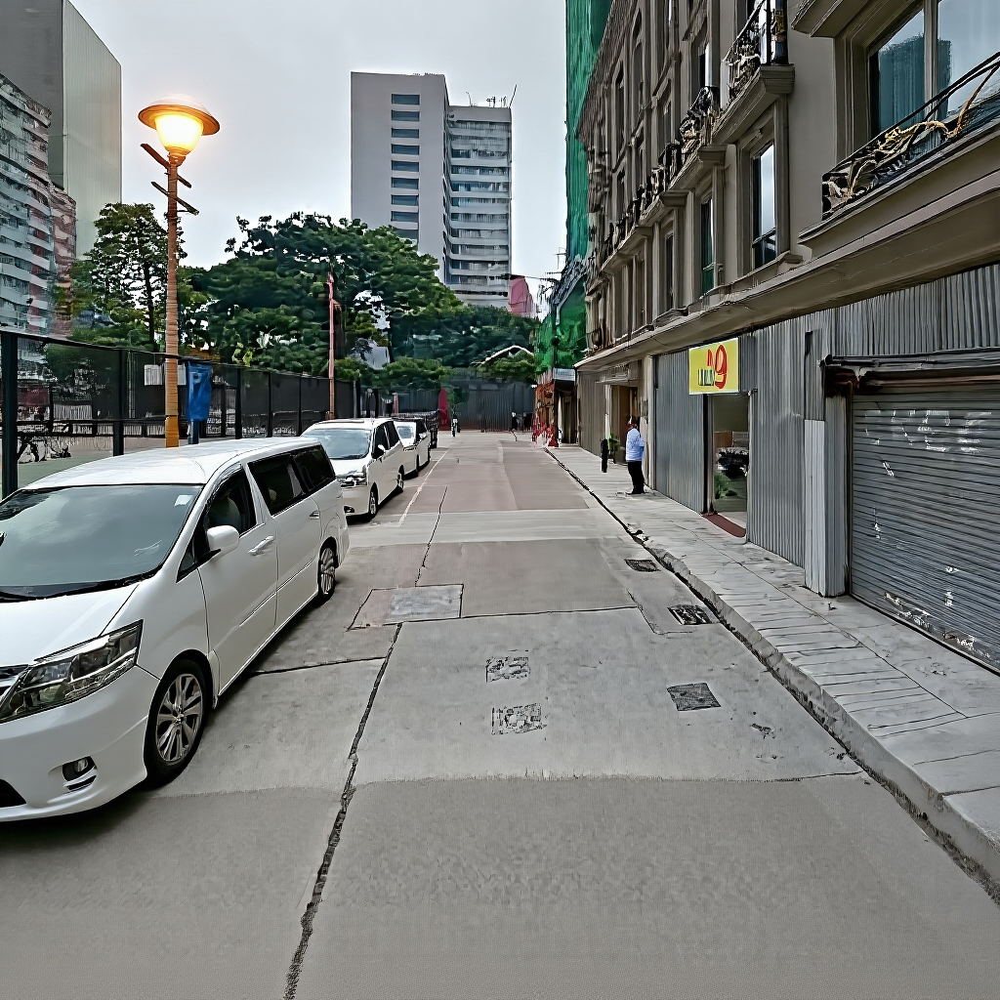

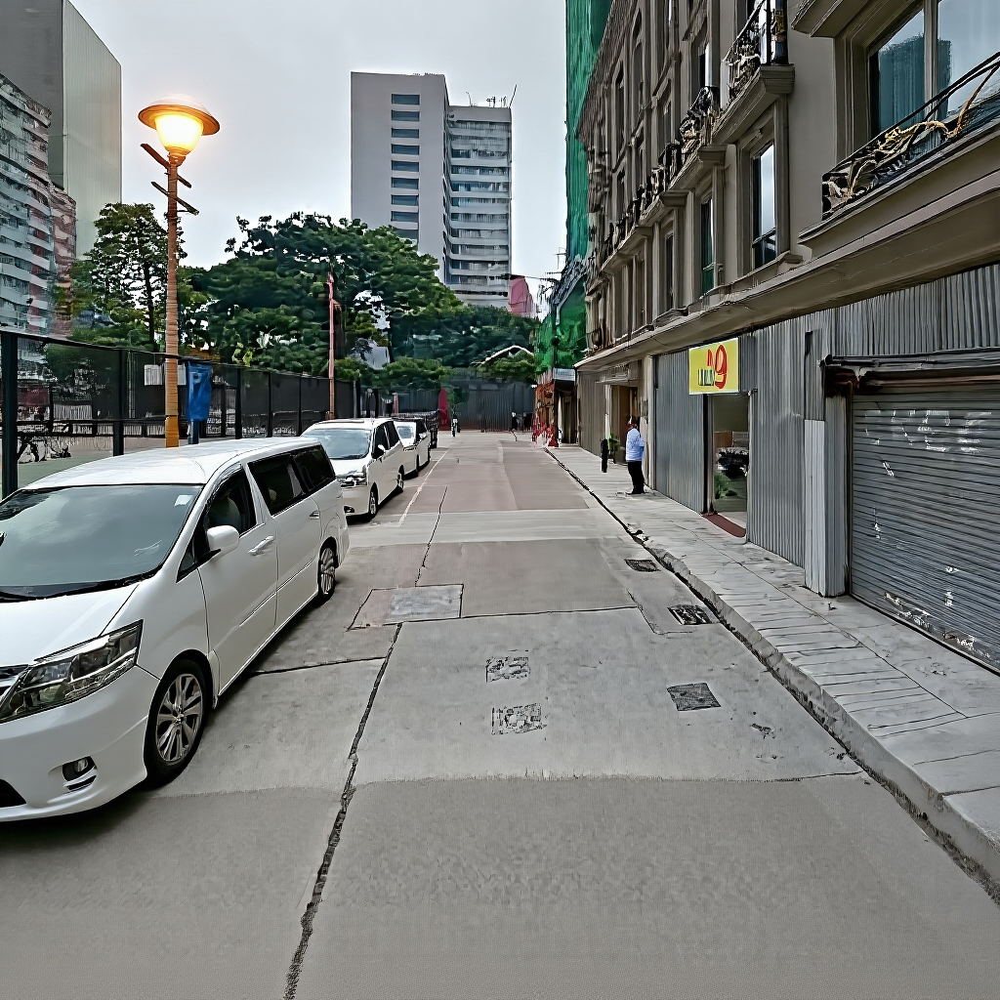

100%|██████████| 28/28 [00:41<00:00,  1.47s/it]


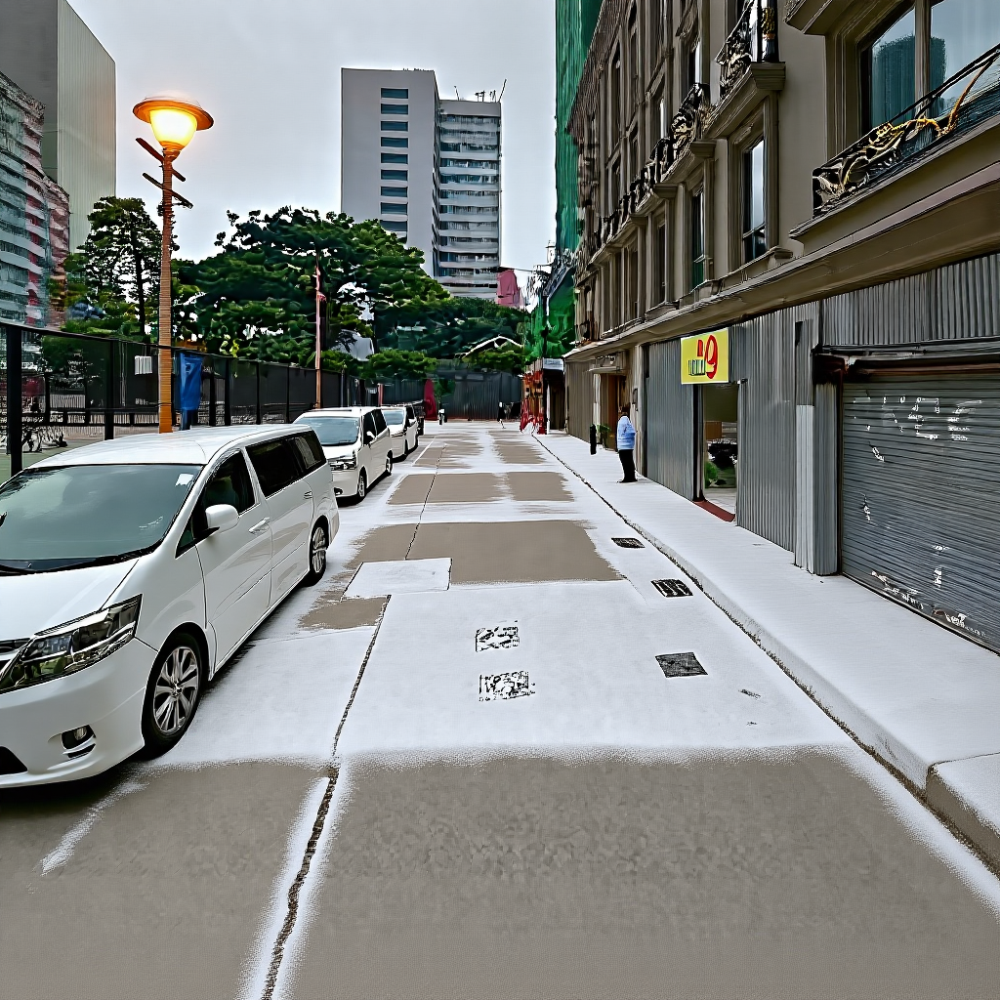

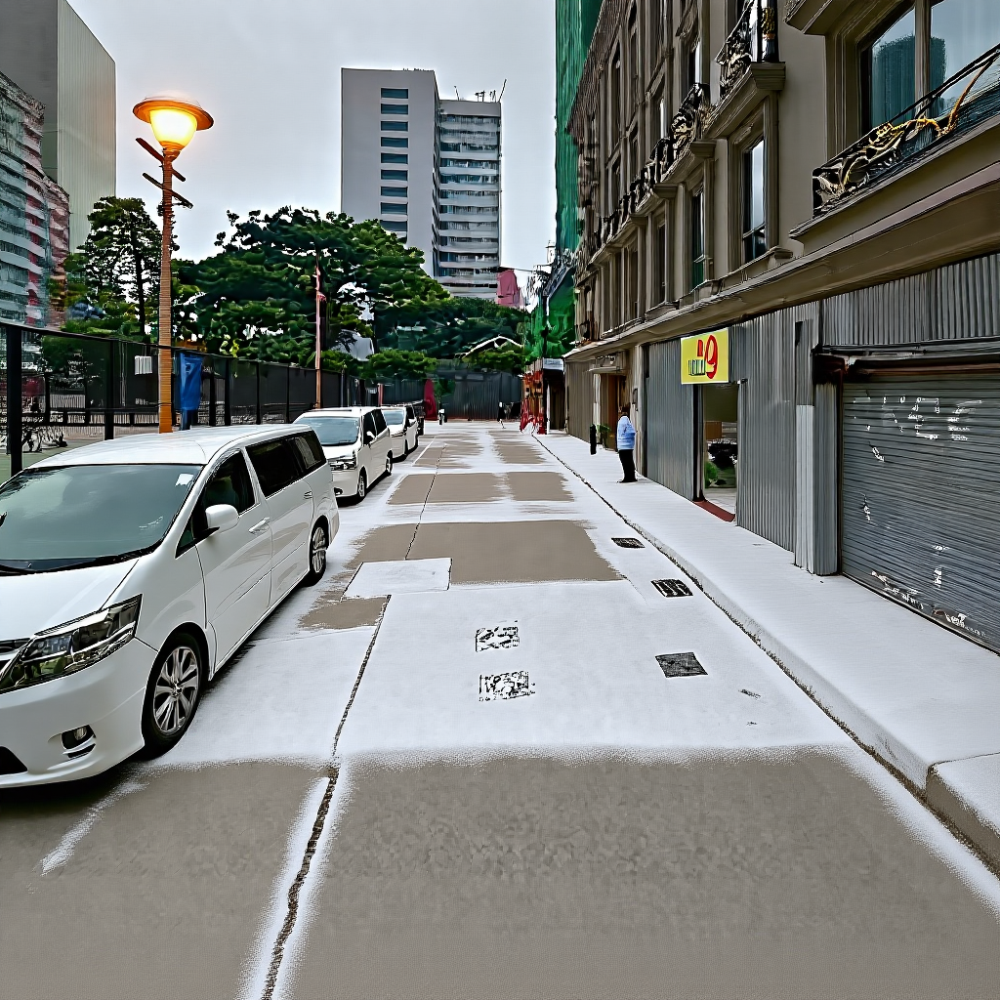

100%|██████████| 28/28 [00:41<00:00,  1.47s/it]


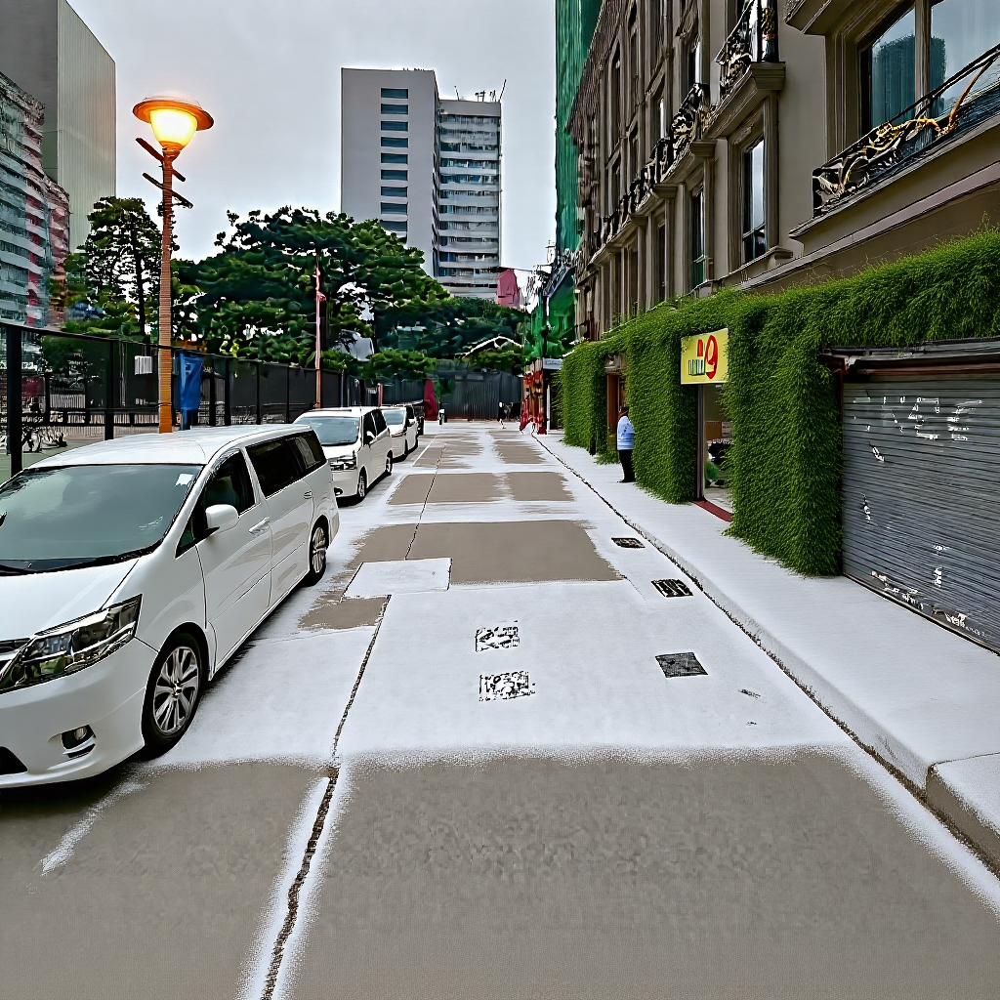

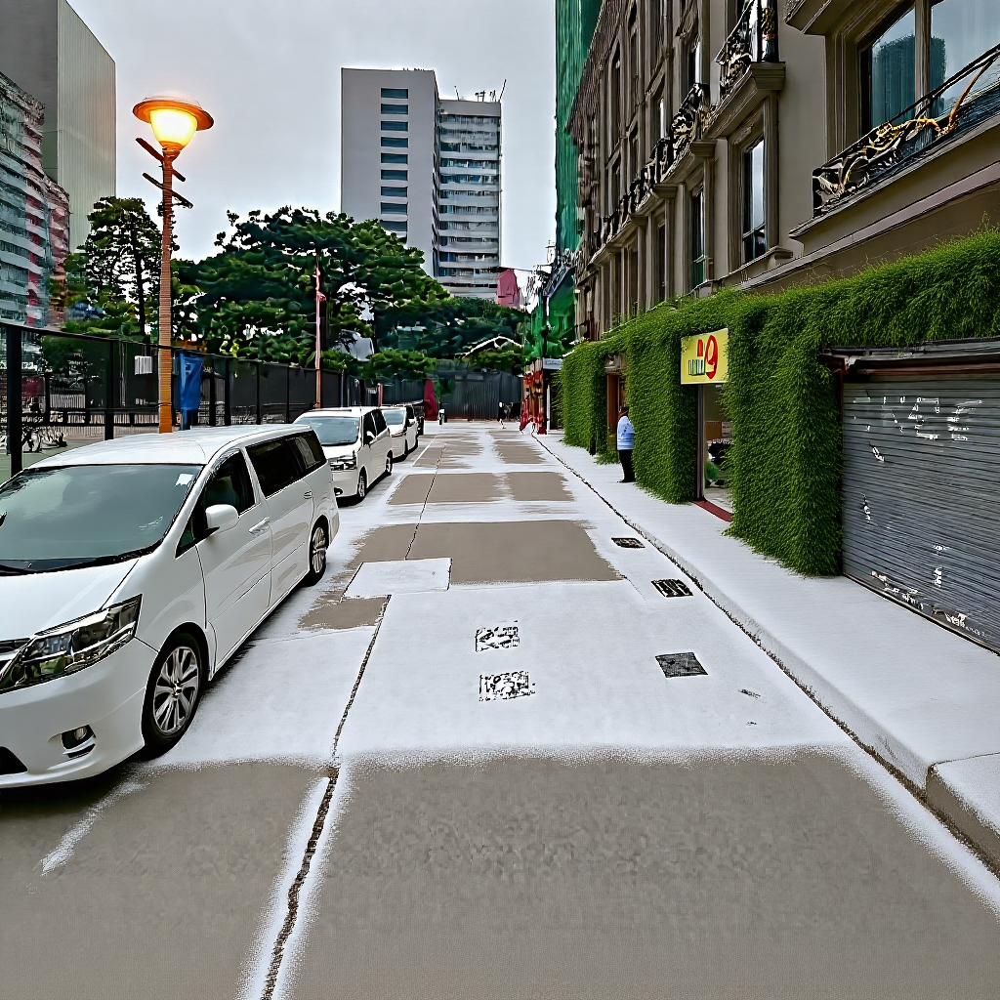

100%|██████████| 28/28 [00:41<00:00,  1.48s/it]


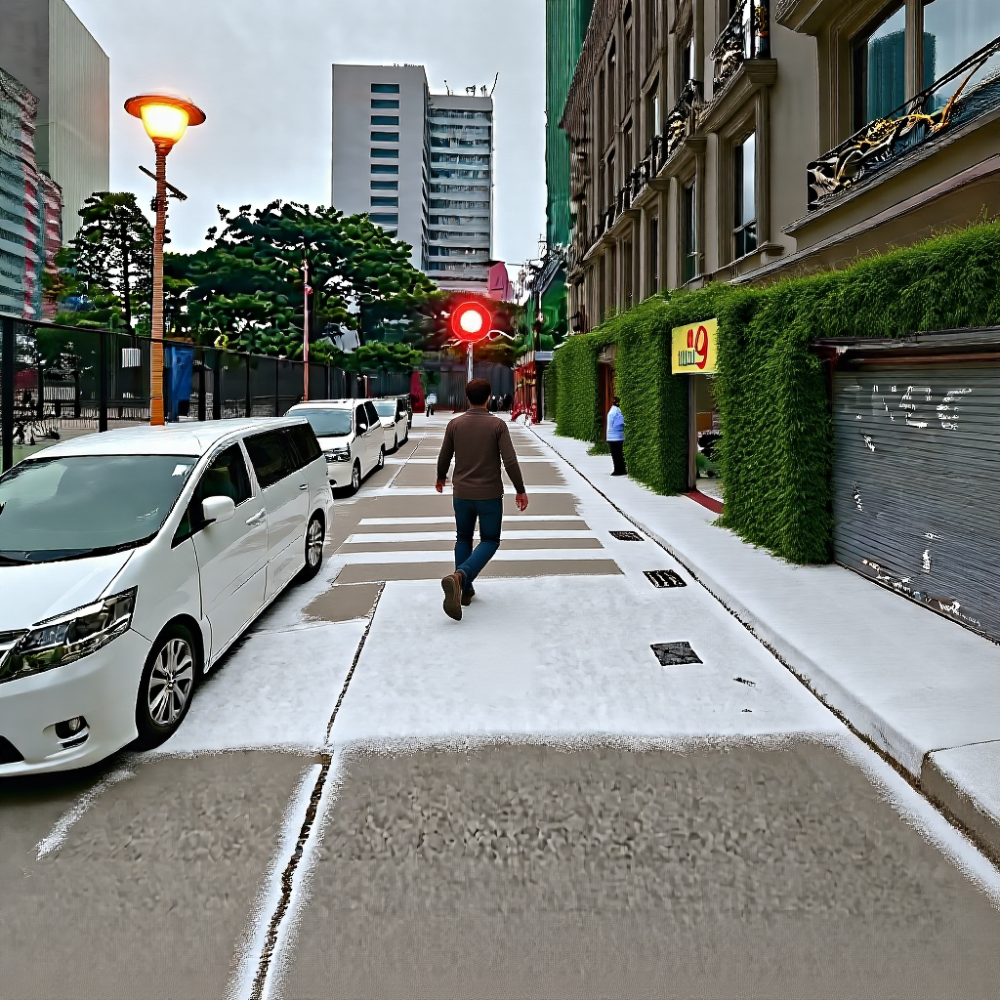

In [11]:
for edit in output:
    # Get image dimensions
    img_w, img_h = image.size

    # # Calculate box coordinates
    # left = edit["bbox_2d"][0]
    # top = edit["bbox_2d"][1]
    # right = edit["bbox_2d"][2]
    # bottom = edit["bbox_2d"][3]

    # # Draw the rectangle
    # draw = ImageDraw.Draw(image)
    # draw.rectangle([left, top, right, bottom], outline="red", width=4)
    
    display(image)
    # image = pipe(image=image, prompt=f"{edit['prompt']} in the red box, while keeping the rest of the image unchanged.", guidance_scale=3.5).images[0]
    image = pipe(image=image, prompt=edit, guidance_scale=3.5).images[0]
    display(image)